In [200]:
import tensorflow as tf
from tensorflow.keras import Sequential
from tensorflow.keras.layers import Dense, Activation, Dropout
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt 
import seaborn as sns
import warnings
import os
import time
import tensorflow_datasets as tfds
warnings.filterwarnings("ignore")

 ## Import Data

In [201]:
data, info = tfds.load("mnist", with_info=True)

In [202]:
train_data = data['train']
ds = train_data.take(5)

['image', 'label']


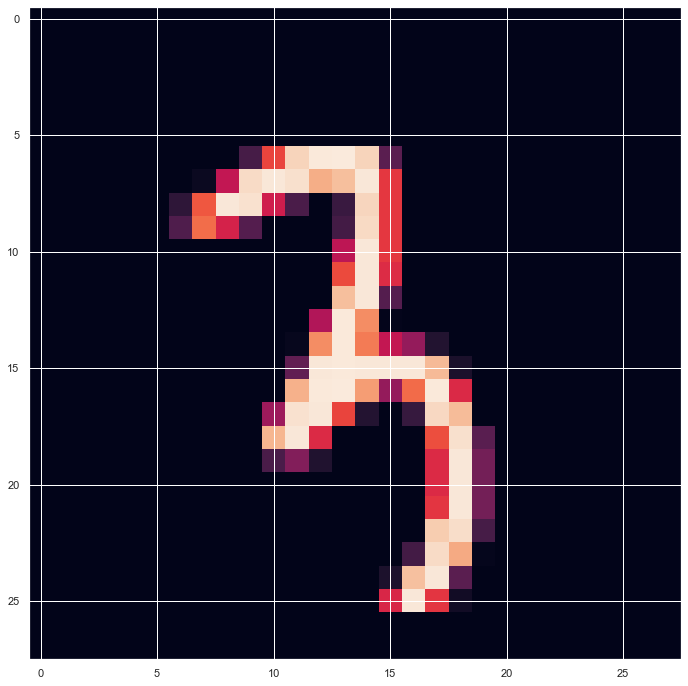

(28, 28, 1)


In [203]:
for example in train_data:
    print(list(example.keys()))
    image = example["image"]
    label = example["label"]
    plt.imshow(image)
    plt.show()
    print(image.shape)
    break

# Training Using Fit

## Model

In [ ]:
class Generator(tf.keras.Model):
    def __init__(self):
        super(Generator, self).__init__()

        self.dense_1 = tf.keras.layers.Dense(128, activation=tf.nn.relu)
        self.dense_2 = tf.keras.layers.Dense(256, activation=tf.nn.relu)
        self.dense_3 = tf.keras.layers.Dense(512, activation=tf.nn.relu)
        self.dense_4 = tf.keras.layers.Dense(28 * 28)
        self.reshape = tf.keras.layers.Reshape((28, 28, 1))

    def call(self, inputs):
        x = self.dense_1(inputs)
        x = self.dense_2(x)
        x = self.dense_3(x)
        x = self.dense_4(x)
        return self.reshape(x)


class Discriminator(tf.keras.Model):
    def __init__(self):
        super(Discriminator, self).__init__()

        self.flatten = tf.keras.layers.Flatten()
        self.dense_1 = tf.keras.layers.Dense(512, activation=tf.nn.leaky_relu )
        self.dense_2 = tf.keras.layers.Dense(256, activation=tf.nn.leaky_relu )
        self.dense_3 = tf.keras.layers.Dense(128, activation=tf.nn.leaky_relu)
        self.dense_4 = tf.keras.layers.Dense(1, activation='sigmoid')

    def call(self, inputs):
        x = self.flatten(inputs)
        x = self.dense_1(x)
        x = self.dense_2(x)
        x = self.dense_3(x)
        return self.dense_4(x)

## Loss Functions

In [1]:
# loss object: Binary Crossentropy Loss
# real_output: Image from Data
# fae_output: Image from Generator
def discriminator_loss(loss_object, real_output, fake_output):
    real_loss = loss_object(tf.ones_like(real_output), real_output)
    fake_loss = loss_object(tf.zeros_like(fake_output), fake_output)
    total_loss = real_loss + fake_loss
    return total_loss

# loss object: Binary Crossentropy Loss
# discriminator_probability: Result from Discriminator 0 = Fake 1 = Real
def generator_loss(loss_object, discriminator_probability):
    return loss_object(tf.ones_like(discriminator_probability), discriminator_probability)

# Normalize Image between [-1,1]
def normalize(x):
    image = tf.cast(x['image'], tf.float32)
    image = (image / 127.5) - 1
    return image

# Save Image sample from Generator
def save_imgs(epoch, generator, noise):
    gen_imgs = generator(noise)

    fig = plt.figure(figsize=(4, 4))

    for i in range(gen_imgs.shape[0]):
        plt.subplot(4, 4, i + 1)
        plt.imshow(gen_imgs[i, :, :, 0] * 127.5 + 127.5, cmap='gray')
        plt.axis('off')

    fig.savefig("images/mnist_%d.png" % epoch)

### Callback: They allow us to save image during training

In [326]:
class Training_Callback(tf.keras.callbacks.Callback):
    def __init__(self, latent_dim, saving_rate):
        super(Training_Callback, self).__init__()
        self.latent_dim = latent_dim
        self.saving_rate = saving_rate
        
    # Save Image sample from Generator
    def save_imgs(self, epoch):
        # Number of images = 16
        seed = tf.random.normal([16, self.latent_dim])
        gen_imgs = self.model.generator(seed)
        
        fig = plt.figure(figsize=(4, 4))

        for i in range(gen_imgs.shape[0]):
            plt.subplot(4, 4, i + 1)
            plt.imshow(gen_imgs[i, :, :, 0] * 127.5 + 127.5, cmap='gray')
            plt.axis('off')

        fig.savefig("images/mnist_%d.png" % epoch)
    
    # Called after each epoch
    def on_epoch_end(self, epoch, logs=None):
        # Save image after 50 epochs
        if epoch % 50 == 0:
            self.save_imgs(epoch)
            
        if epoch > 0 and epoch % self.saving_rate == 0:
            save_dir = "./models/model_epoch_" + str(epoch)
            if not os.path.exists(save_dir):
                os.makedirs(save_dir)
            self.model.discriminator.save_weights(save_dir + '/discriminator_%d' % epoch)
            self.model.generator.save_weights(save_dir + '/generator_%d' % epoch)
            
        self.best_weights = self.model.get_weights()

## Modify train_step function

In [327]:
class GAN(tf.keras.Model):
    # define the models
    def __init__(self, discriminator, generator, latent_dim):
        super(GAN, self).__init__()
        self.discriminator = discriminator
        self.generator = generator
        self.latent_dim = latent_dim
    
    # Define the compiler
    def compile(self, disc_optimizer, gen_optimizer, loss_fn, generator_loss, discriminator_loss):
        super(GAN, self).compile()
        self.disc_optimizer = disc_optimizer
        self.gen_optimizer = gen_optimizer
        self.generator_loss = generator_loss
        self.discriminator_loss = discriminator_loss
        self.loss_fn = loss_fn

        
    # @tf.function: The below function is completely Tensor Code
    # Good for optimization
    @tf.function
    # Modify Train step for GAN
    def train_step(self, images):
        batch_size = tf.shape(images)[0]
        noise = tf.random.normal([batch_size, self.latent_dim])

        # Define the loss function
        with tf.GradientTape(persistent=True) as tape:
            generated_images = self.generator(noise)
            real_output = self.discriminator(images)
            fake_output = self.discriminator(generated_images)
            
            gen_loss = self.generator_loss(self.loss_fn, fake_output)
            disc_loss = self.discriminator_loss(self.loss_fn, real_output, fake_output)

        # Calculate Gradient
        grad_disc = tape.gradient(disc_loss, self.discriminator.trainable_variables)
        grad_gen = tape.gradient(gen_loss, self.generator.trainable_variables)

        # Optimization Step: Update Weights & Learning Rate
        self.disc_optimizer.apply_gradients(zip(grad_disc, self.discriminator.trainable_variables))
        self.gen_optimizer.apply_gradients(zip(grad_gen, self.generator.trainable_variables))
        
        return {"Gen Loss ": gen_loss,"Disc Loss" : disc_loss}

### Set Hyperparameters

In [328]:
latent_dim = 10
epochs = 1000
# Reduce Batch Size if GPU memory overflow
# Better Use Google Colab
batch_size = 2000
# Save model after every
saving_rate = 100

# Random Seed for Shuffling Data
buffer_size = 5000

# defining optimizer for Models
gen_optimizer = tf.keras.optimizers.Adam(0.0001)
disc_optimizer = tf.keras.optimizers.Adam(0.0001)

# Shuffle & Batch Data
train_dataset = train_data.map(normalize).shuffle(buffer_size , reshuffle_each_iteration=True).batch(batch_size)

# Define Loss Function
cross_entropy = tf.keras.losses.BinaryCrossentropy(from_logits=True)

### Create GAN & Compiler

In [329]:
disc = Discriminator()
gen = Generator()

In [330]:
gan = GAN(discriminator=disc, generator=gen, latent_dim=latent_dim)
gan.compile(
    disc_optimizer=disc_optimizer,
    gen_optimizer=gen_optimizer,
    loss_fn=cross_entropy,
    generator_loss = generator_loss,
    discriminator_loss = discriminator_loss
)

### Train Data

Epoch 1/5000
30/30 [==============================] - 2s 47ms/step - Gen Loss : 0.6418 - Disc Loss: 0.7681
Epoch 2/5000
30/30 [==============================] - 1s 38ms/step - Gen Loss : 0.9525 - Disc Loss: 0.5154
Epoch 3/5000
30/30 [==============================] - 2s 49ms/step - Gen Loss : 1.1817 - Disc Loss: 0.3877
Epoch 4/5000
30/30 [==============================] - 1s 38ms/step - Gen Loss : 1.4807 - Disc Loss: 0.2763
Epoch 5/5000
30/30 [==============================] - 1s 42ms/step - Gen Loss : 1.7638 - Disc Loss: 0.2066
Epoch 6/5000
30/30 [==============================] - 1s 39ms/step - Gen Loss : 2.0226 - Disc Loss: 0.1651
Epoch 7/5000
30/30 [==============================] - 2s 49ms/step - Gen Loss : 2.2947 - Disc Loss: 0.1267
Epoch 8/5000
30/30 [==============================] - 2s 54ms/step - Gen Loss : 2.5663 - Disc Loss: 0.0969
Epoch 9/5000
30/30 [==============================] - 2s 50ms/step - Gen Loss : 2.2591 - Disc Loss: 0.1248
Epoch 10/5000
30/30 [================

30/30 [==============================] - 2s 55ms/step - Gen Loss : 6.5440 - Disc Loss: 0.1394
Epoch 152/5000
30/30 [==============================] - 2s 59ms/step - Gen Loss : 6.1011 - Disc Loss: 0.0801
Epoch 153/5000
30/30 [==============================] - 2s 59ms/step - Gen Loss : 5.6195 - Disc Loss: 0.1057
Epoch 154/5000
30/30 [==============================] - 1s 45ms/step - Gen Loss : 5.7753 - Disc Loss: 0.1026
Epoch 155/5000
30/30 [==============================] - 2s 56ms/step - Gen Loss : 5.8351 - Disc Loss: 0.0938
Epoch 156/5000
30/30 [==============================] - 2s 59ms/step - Gen Loss : 6.1974 - Disc Loss: 0.0674
Epoch 157/5000
30/30 [==============================] - 2s 58ms/step - Gen Loss : 5.6982 - Disc Loss: 0.0741
Epoch 158/5000
30/30 [==============================] - 2s 56ms/step - Gen Loss : 5.2213 - Disc Loss: 0.0833
Epoch 159/5000
30/30 [==============================] - 2s 57ms/step - Gen Loss : 5.0912 - Disc Loss: 0.0513
Epoch 160/5000
30/30 [============

30/30 [==============================] - 2s 56ms/step - Gen Loss : 5.8674 - Disc Loss: 0.0219
Epoch 302/5000
30/30 [==============================] - 2s 50ms/step - Gen Loss : 6.6651 - Disc Loss: 0.0249
Epoch 303/5000
30/30 [==============================] - 2s 49ms/step - Gen Loss : 9.3800 - Disc Loss: 0.1100
Epoch 304/5000
30/30 [==============================] - 2s 58ms/step - Gen Loss : 20.1824 - Disc Loss: 0.1005
Epoch 305/5000
30/30 [==============================] - 2s 60ms/step - Gen Loss : 6.5790 - Disc Loss: 0.0707
Epoch 306/5000
30/30 [==============================] - 2s 55ms/step - Gen Loss : 5.3966 - Disc Loss: 0.0646
Epoch 307/5000
30/30 [==============================] - 2s 55ms/step - Gen Loss : 5.4650 - Disc Loss: 0.0695
Epoch 308/5000
30/30 [==============================] - 2s 57ms/step - Gen Loss : 5.3245 - Disc Loss: 0.0547
Epoch 309/5000
30/30 [==============================] - 2s 59ms/step - Gen Loss : 5.5068 - Disc Loss: 0.0328
Epoch 310/5000
30/30 [===========

30/30 [==============================] - 1s 45ms/step - Gen Loss : 6.1601 - Disc Loss: 0.1057
Epoch 452/5000
30/30 [==============================] - 2s 52ms/step - Gen Loss : 13.4014 - Disc Loss: 0.2032
Epoch 453/5000
30/30 [==============================] - 2s 60ms/step - Gen Loss : 5.6503 - Disc Loss: 0.1131
Epoch 454/5000
30/30 [==============================] - 2s 58ms/step - Gen Loss : 4.5897 - Disc Loss: 0.0782
Epoch 455/5000
30/30 [==============================] - 1s 46ms/step - Gen Loss : 4.1694 - Disc Loss: 0.0861
Epoch 456/5000
30/30 [==============================] - 2s 53ms/step - Gen Loss : 4.0309 - Disc Loss: 0.1179
Epoch 457/5000
30/30 [==============================] - 2s 58ms/step - Gen Loss : 4.2334 - Disc Loss: 0.1013
Epoch 458/5000
30/30 [==============================] - 1s 44ms/step - Gen Loss : 4.7532 - Disc Loss: 0.0780
Epoch 459/5000
30/30 [==============================] - 2s 54ms/step - Gen Loss : 5.0645 - Disc Loss: 0.0864
Epoch 460/5000
30/30 [===========

30/30 [==============================] - 2s 59ms/step - Gen Loss : 5.4490 - Disc Loss: 0.0764
Epoch 602/5000
30/30 [==============================] - 2s 57ms/step - Gen Loss : 5.3096 - Disc Loss: 0.0758
Epoch 603/5000
30/30 [==============================] - 2s 57ms/step - Gen Loss : 5.1230 - Disc Loss: 0.0639
Epoch 604/5000
30/30 [==============================] - 2s 59ms/step - Gen Loss : 4.8865 - Disc Loss: 0.0565
Epoch 605/5000
30/30 [==============================] - 2s 49ms/step - Gen Loss : 4.7074 - Disc Loss: 0.0620
Epoch 606/5000
30/30 [==============================] - 2s 58ms/step - Gen Loss : 4.6245 - Disc Loss: 0.0706
Epoch 607/5000
30/30 [==============================] - 2s 60ms/step - Gen Loss : 4.8647 - Disc Loss: 0.0592
Epoch 608/5000
30/30 [==============================] - 2s 56ms/step - Gen Loss : 5.0265 - Disc Loss: 0.0926
Epoch 609/5000
30/30 [==============================] - 2s 60ms/step - Gen Loss : 5.3305 - Disc Loss: 0.0829
Epoch 610/5000
30/30 [============

30/30 [==============================] - 1s 44ms/step - Gen Loss : 5.7619 - Disc Loss: 0.0893
Epoch 752/5000
30/30 [==============================] - 2s 60ms/step - Gen Loss : 5.3989 - Disc Loss: 0.0887
Epoch 753/5000
30/30 [==============================] - 2s 60ms/step - Gen Loss : 5.3590 - Disc Loss: 0.0747
Epoch 754/5000
30/30 [==============================] - 2s 58ms/step - Gen Loss : 5.2291 - Disc Loss: 0.0748
Epoch 755/5000
30/30 [==============================] - 2s 60ms/step - Gen Loss : 5.1487 - Disc Loss: 0.0789
Epoch 756/5000
30/30 [==============================] - 2s 48ms/step - Gen Loss : 5.1009 - Disc Loss: 0.0765
Epoch 757/5000
30/30 [==============================] - 1s 47ms/step - Gen Loss : 5.2853 - Disc Loss: 0.0632
Epoch 758/5000
30/30 [==============================] - 2s 59ms/step - Gen Loss : 5.2560 - Disc Loss: 0.0624
Epoch 759/5000
30/30 [==============================] - 2s 59ms/step - Gen Loss : 5.1243 - Disc Loss: 0.0605
Epoch 760/5000
30/30 [============

30/30 [==============================] - 2s 57ms/step - Gen Loss : 6.1035 - Disc Loss: 0.0743
Epoch 902/5000
30/30 [==============================] - 2s 59ms/step - Gen Loss : 6.0859 - Disc Loss: 0.0613
Epoch 903/5000
30/30 [==============================] - 2s 47ms/step - Gen Loss : 6.2378 - Disc Loss: 0.0621
Epoch 904/5000
30/30 [==============================] - 2s 51ms/step - Gen Loss : 6.1450 - Disc Loss: 0.0701
Epoch 905/5000
30/30 [==============================] - 2s 60ms/step - Gen Loss : 11.0630 - Disc Loss: 0.4124
Epoch 906/5000
30/30 [==============================] - 2s 59ms/step - Gen Loss : 7.9949 - Disc Loss: 0.0975
Epoch 907/5000
30/30 [==============================] - 2s 58ms/step - Gen Loss : 4.2235 - Disc Loss: 0.1285
Epoch 908/5000
30/30 [==============================] - 1s 43ms/step - Gen Loss : 4.5480 - Disc Loss: 0.0913
Epoch 909/5000
30/30 [==============================] - 2s 52ms/step - Gen Loss : 4.4697 - Disc Loss: 0.1068
Epoch 910/5000
30/30 [===========

30/30 [==============================] - 2s 59ms/step - Gen Loss : 5.1722 - Disc Loss: 0.0730
Epoch 1051/5000
30/30 [==============================] - 2s 56ms/step - Gen Loss : 5.3836 - Disc Loss: 0.0785
Epoch 1052/5000
30/30 [==============================] - 2s 59ms/step - Gen Loss : 5.9559 - Disc Loss: 0.0830
Epoch 1053/5000
30/30 [==============================] - 2s 59ms/step - Gen Loss : 5.8205 - Disc Loss: 0.0764
Epoch 1054/5000
30/30 [==============================] - 1s 44ms/step - Gen Loss : 6.0542 - Disc Loss: 0.0795
Epoch 1055/5000
30/30 [==============================] - 2s 57ms/step - Gen Loss : 6.1996 - Disc Loss: 0.0788
Epoch 1056/5000
30/30 [==============================] - 2s 60ms/step - Gen Loss : 6.0318 - Disc Loss: 0.0713
Epoch 1057/5000
30/30 [==============================] - 2s 59ms/step - Gen Loss : 7.0487 - Disc Loss: 0.0852
Epoch 1058/5000
30/30 [==============================] - 1s 44ms/step - Gen Loss : 6.2646 - Disc Loss: 0.0849
Epoch 1059/5000
30/30 [===

30/30 [==============================] - 2s 59ms/step - Gen Loss : 6.8462 - Disc Loss: 0.0916
Epoch 1199/5000
30/30 [==============================] - 1s 44ms/step - Gen Loss : 6.1444 - Disc Loss: 0.0874
Epoch 1200/5000
30/30 [==============================] - 2s 52ms/step - Gen Loss : 6.1193 - Disc Loss: 0.0722
Epoch 1201/5000
30/30 [==============================] - 2s 57ms/step - Gen Loss : 6.1616 - Disc Loss: 0.0735
Epoch 1202/5000
30/30 [==============================] - 2s 57ms/step - Gen Loss : 6.3503 - Disc Loss: 0.0829
Epoch 1203/5000
30/30 [==============================] - 2s 56ms/step - Gen Loss : 6.5919 - Disc Loss: 0.0729
Epoch 1204/5000
30/30 [==============================] - 2s 50ms/step - Gen Loss : 6.5432 - Disc Loss: 0.0741
Epoch 1205/5000
30/30 [==============================] - 2s 53ms/step - Gen Loss : 6.0977 - Disc Loss: 0.0905
Epoch 1206/5000
30/30 [==============================] - 1s 47ms/step - Gen Loss : 5.8351 - Disc Loss: 0.0884
Epoch 1207/5000
30/30 [===

30/30 [==============================] - 2s 57ms/step - Gen Loss : 6.2424 - Disc Loss: 0.0847
Epoch 1347/5000
30/30 [==============================] - 2s 59ms/step - Gen Loss : 6.4458 - Disc Loss: 0.0860
Epoch 1348/5000
30/30 [==============================] - 1s 45ms/step - Gen Loss : 6.3842 - Disc Loss: 0.0933
Epoch 1349/5000
30/30 [==============================] - 2s 59ms/step - Gen Loss : 6.1347 - Disc Loss: 0.0816
Epoch 1350/5000
30/30 [==============================] - 2s 61ms/step - Gen Loss : 5.9430 - Disc Loss: 0.0831
Epoch 1351/5000
30/30 [==============================] - 2s 57ms/step - Gen Loss : 5.9152 - Disc Loss: 0.0743
Epoch 1352/5000
30/30 [==============================] - 2s 50ms/step - Gen Loss : 5.8031 - Disc Loss: 0.0848
Epoch 1353/5000
30/30 [==============================] - 1s 45ms/step - Gen Loss : 5.6848 - Disc Loss: 0.0819
Epoch 1354/5000
30/30 [==============================] - 2s 54ms/step - Gen Loss : 5.6911 - Disc Loss: 0.0846
Epoch 1355/5000
30/30 [===

30/30 [==============================] - 2s 55ms/step - Gen Loss : 5.9066 - Disc Loss: 0.0986
Epoch 1495/5000
30/30 [==============================] - 2s 60ms/step - Gen Loss : 5.7712 - Disc Loss: 0.1278
Epoch 1496/5000
30/30 [==============================] - 2s 51ms/step - Gen Loss : 5.9439 - Disc Loss: 0.1177
Epoch 1497/5000
30/30 [==============================] - 2s 53ms/step - Gen Loss : 6.5436 - Disc Loss: 0.1126
Epoch 1498/5000
30/30 [==============================] - 2s 55ms/step - Gen Loss : 6.2458 - Disc Loss: 0.1283
Epoch 1499/5000
30/30 [==============================] - 2s 50ms/step - Gen Loss : 6.2131 - Disc Loss: 0.1189
Epoch 1500/5000
30/30 [==============================] - 2s 51ms/step - Gen Loss : 6.0265 - Disc Loss: 0.1173
Epoch 1501/5000
30/30 [==============================] - 2s 49ms/step - Gen Loss : 5.8956 - Disc Loss: 0.1189
Epoch 1502/5000
30/30 [==============================] - 1s 43ms/step - Gen Loss : 6.0291 - Disc Loss: 0.0972
Epoch 1503/5000
30/30 [===

30/30 [==============================] - 2s 59ms/step - Gen Loss : 5.9055 - Disc Loss: 0.1393
Epoch 1643/5000
30/30 [==============================] - 2s 59ms/step - Gen Loss : 5.9747 - Disc Loss: 0.1136
Epoch 1644/5000
30/30 [==============================] - 2s 60ms/step - Gen Loss : 5.8984 - Disc Loss: 0.1350
Epoch 1645/5000
30/30 [==============================] - 2s 52ms/step - Gen Loss : 5.8784 - Disc Loss: 0.1562
Epoch 1646/5000
30/30 [==============================] - 2s 54ms/step - Gen Loss : 6.1120 - Disc Loss: 0.1495
Epoch 1647/5000
30/30 [==============================] - 2s 53ms/step - Gen Loss : 6.2309 - Disc Loss: 0.1195
Epoch 1648/5000
30/30 [==============================] - 2s 50ms/step - Gen Loss : 5.7804 - Disc Loss: 0.1350
Epoch 1649/5000
30/30 [==============================] - 2s 56ms/step - Gen Loss : 5.6160 - Disc Loss: 0.1348
Epoch 1650/5000
30/30 [==============================] - 2s 56ms/step - Gen Loss : 5.2948 - Disc Loss: 0.1495
Epoch 1651/5000
30/30 [===

30/30 [==============================] - 2s 59ms/step - Gen Loss : 5.3016 - Disc Loss: 0.1212
Epoch 1791/5000
30/30 [==============================] - 2s 56ms/step - Gen Loss : 5.1250 - Disc Loss: 0.1435
Epoch 1792/5000
30/30 [==============================] - 2s 59ms/step - Gen Loss : 5.1349 - Disc Loss: 0.1364
Epoch 1793/5000
30/30 [==============================] - 2s 56ms/step - Gen Loss : 5.1710 - Disc Loss: 0.1381
Epoch 1794/5000
30/30 [==============================] - 2s 52ms/step - Gen Loss : 5.3302 - Disc Loss: 0.1232
Epoch 1795/5000
30/30 [==============================] - 2s 50ms/step - Gen Loss : 5.2443 - Disc Loss: 0.1566
Epoch 1796/5000
30/30 [==============================] - 2s 52ms/step - Gen Loss : 5.3584 - Disc Loss: 0.1419
Epoch 1797/5000
30/30 [==============================] - 2s 56ms/step - Gen Loss : 5.0638 - Disc Loss: 0.1694
Epoch 1798/5000
30/30 [==============================] - 2s 54ms/step - Gen Loss : 5.5312 - Disc Loss: 0.1611
Epoch 1799/5000
30/30 [===

30/30 [==============================] - 2s 56ms/step - Gen Loss : 5.0287 - Disc Loss: 0.1478
Epoch 1939/5000
30/30 [==============================] - 2s 56ms/step - Gen Loss : 5.0643 - Disc Loss: 0.1388
Epoch 1940/5000
30/30 [==============================] - 2s 53ms/step - Gen Loss : 5.3009 - Disc Loss: 0.1517
Epoch 1941/5000
30/30 [==============================] - 2s 56ms/step - Gen Loss : 5.0654 - Disc Loss: 0.1939
Epoch 1942/5000
30/30 [==============================] - 2s 58ms/step - Gen Loss : 5.2857 - Disc Loss: 0.1613
Epoch 1943/5000
30/30 [==============================] - 2s 53ms/step - Gen Loss : 4.9943 - Disc Loss: 0.1959
Epoch 1944/5000
30/30 [==============================] - 2s 54ms/step - Gen Loss : 5.2240 - Disc Loss: 0.1713
Epoch 1945/5000
30/30 [==============================] - 2s 57ms/step - Gen Loss : 5.2703 - Disc Loss: 0.1944
Epoch 1946/5000
30/30 [==============================] - 2s 54ms/step - Gen Loss : 5.1347 - Disc Loss: 0.1902
Epoch 1947/5000
30/30 [===

30/30 [==============================] - 2s 56ms/step - Gen Loss : 4.6440 - Disc Loss: 0.2067
Epoch 2087/5000
30/30 [==============================] - 2s 57ms/step - Gen Loss : 5.2579 - Disc Loss: 0.1768
Epoch 2088/5000
30/30 [==============================] - 2s 55ms/step - Gen Loss : 5.4094 - Disc Loss: 0.1823
Epoch 2089/5000
30/30 [==============================] - 2s 59ms/step - Gen Loss : 5.1239 - Disc Loss: 0.1880
Epoch 2090/5000
30/30 [==============================] - 2s 53ms/step - Gen Loss : 4.9191 - Disc Loss: 0.1642
Epoch 2091/5000
30/30 [==============================] - 2s 56ms/step - Gen Loss : 5.0250 - Disc Loss: 0.1732
Epoch 2092/5000
30/30 [==============================] - 2s 56ms/step - Gen Loss : 4.8819 - Disc Loss: 0.2226
Epoch 2093/5000
30/30 [==============================] - 2s 55ms/step - Gen Loss : 5.2314 - Disc Loss: 0.1856
Epoch 2094/5000
30/30 [==============================] - 2s 55ms/step - Gen Loss : 5.1213 - Disc Loss: 0.1980
Epoch 2095/5000
30/30 [===

30/30 [==============================] - 2s 54ms/step - Gen Loss : 5.0814 - Disc Loss: 0.1920
Epoch 2235/5000
30/30 [==============================] - 2s 56ms/step - Gen Loss : 4.9230 - Disc Loss: 0.1949
Epoch 2236/5000
30/30 [==============================] - 2s 54ms/step - Gen Loss : 4.8093 - Disc Loss: 0.1892
Epoch 2237/5000
30/30 [==============================] - 2s 56ms/step - Gen Loss : 4.9537 - Disc Loss: 0.1731
Epoch 2238/5000
30/30 [==============================] - 2s 58ms/step - Gen Loss : 4.8429 - Disc Loss: 0.2256
Epoch 2239/5000
30/30 [==============================] - 2s 54ms/step - Gen Loss : 5.1628 - Disc Loss: 0.2174
Epoch 2240/5000
30/30 [==============================] - 2s 54ms/step - Gen Loss : 4.7755 - Disc Loss: 0.2542
Epoch 2241/5000
30/30 [==============================] - 2s 57ms/step - Gen Loss : 4.8091 - Disc Loss: 0.2217
Epoch 2242/5000
30/30 [==============================] - 2s 57ms/step - Gen Loss : 4.8035 - Disc Loss: 0.2281
Epoch 2243/5000
30/30 [===

30/30 [==============================] - 2s 54ms/step - Gen Loss : 5.0362 - Disc Loss: 0.2020
Epoch 2383/5000
30/30 [==============================] - 2s 58ms/step - Gen Loss : 5.0058 - Disc Loss: 0.2301
Epoch 2384/5000
30/30 [==============================] - 2s 56ms/step - Gen Loss : 4.5622 - Disc Loss: 0.2280
Epoch 2385/5000
30/30 [==============================] - 2s 49ms/step - Gen Loss : 4.7546 - Disc Loss: 0.1991
Epoch 2386/5000
30/30 [==============================] - 2s 56ms/step - Gen Loss : 5.0031 - Disc Loss: 0.1737
Epoch 2387/5000
30/30 [==============================] - 2s 53ms/step - Gen Loss : 5.2720 - Disc Loss: 0.1516
Epoch 2388/5000
30/30 [==============================] - 2s 50ms/step - Gen Loss : 4.9142 - Disc Loss: 0.2148
Epoch 2389/5000
30/30 [==============================] - 2s 50ms/step - Gen Loss : 5.0957 - Disc Loss: 0.1951
Epoch 2390/5000
30/30 [==============================] - 2s 49ms/step - Gen Loss : 5.0969 - Disc Loss: 0.2230
Epoch 2391/5000
30/30 [===

30/30 [==============================] - 2s 53ms/step - Gen Loss : 4.4152 - Disc Loss: 0.2257
Epoch 2531/5000
30/30 [==============================] - 2s 58ms/step - Gen Loss : 4.5448 - Disc Loss: 0.2307
Epoch 2532/5000
30/30 [==============================] - 2s 58ms/step - Gen Loss : 4.6830 - Disc Loss: 0.2171
Epoch 2533/5000
30/30 [==============================] - 2s 59ms/step - Gen Loss : 4.5857 - Disc Loss: 0.2529
Epoch 2534/5000
30/30 [==============================] - 2s 54ms/step - Gen Loss : 4.4556 - Disc Loss: 0.2525
Epoch 2535/5000
30/30 [==============================] - 2s 58ms/step - Gen Loss : 4.1887 - Disc Loss: 0.2762
Epoch 2536/5000
30/30 [==============================] - 2s 51ms/step - Gen Loss : 4.6307 - Disc Loss: 0.2328
Epoch 2537/5000
30/30 [==============================] - 2s 56ms/step - Gen Loss : 4.8451 - Disc Loss: 0.2800
Epoch 2538/5000
30/30 [==============================] - 2s 52ms/step - Gen Loss : 4.9022 - Disc Loss: 0.2706
Epoch 2539/5000
30/30 [===

30/30 [==============================] - 2s 53ms/step - Gen Loss : 4.4335 - Disc Loss: 0.2195
Epoch 2679/5000
30/30 [==============================] - 2s 49ms/step - Gen Loss : 4.6224 - Disc Loss: 0.2255
Epoch 2680/5000
30/30 [==============================] - 2s 50ms/step - Gen Loss : 4.6976 - Disc Loss: 0.2547
Epoch 2681/5000
30/30 [==============================] - 2s 53ms/step - Gen Loss : 4.6579 - Disc Loss: 0.2687
Epoch 2682/5000
30/30 [==============================] - 2s 56ms/step - Gen Loss : 4.9227 - Disc Loss: 0.2292
Epoch 2683/5000
30/30 [==============================] - 2s 56ms/step - Gen Loss : 4.5033 - Disc Loss: 0.2503
Epoch 2684/5000
30/30 [==============================] - 2s 57ms/step - Gen Loss : 4.1213 - Disc Loss: 0.2901
Epoch 2685/5000
30/30 [==============================] - 2s 58ms/step - Gen Loss : 4.2172 - Disc Loss: 0.2524
Epoch 2686/5000
30/30 [==============================] - 2s 58ms/step - Gen Loss : 4.4878 - Disc Loss: 0.2181
Epoch 2687/5000
30/30 [===

30/30 [==============================] - 2s 53ms/step - Gen Loss : 4.9215 - Disc Loss: 0.2282
Epoch 2827/5000
30/30 [==============================] - 2s 50ms/step - Gen Loss : 4.5038 - Disc Loss: 0.2741
Epoch 2828/5000
30/30 [==============================] - 2s 56ms/step - Gen Loss : 4.7612 - Disc Loss: 0.2400
Epoch 2829/5000
30/30 [==============================] - 2s 52ms/step - Gen Loss : 4.4658 - Disc Loss: 0.2824
Epoch 2830/5000
30/30 [==============================] - 2s 56ms/step - Gen Loss : 4.6922 - Disc Loss: 0.2608
Epoch 2831/5000
30/30 [==============================] - 2s 52ms/step - Gen Loss : 4.3401 - Disc Loss: 0.2966
Epoch 2832/5000
30/30 [==============================] - 2s 50ms/step - Gen Loss : 4.2837 - Disc Loss: 0.2595
Epoch 2833/5000
30/30 [==============================] - 2s 50ms/step - Gen Loss : 4.4483 - Disc Loss: 0.2104
Epoch 2834/5000
30/30 [==============================] - 2s 56ms/step - Gen Loss : 4.1214 - Disc Loss: 0.2461
Epoch 2835/5000
30/30 [===

30/30 [==============================] - 2s 48ms/step - Gen Loss : 4.4601 - Disc Loss: 0.2975
Epoch 2975/5000
30/30 [==============================] - 2s 49ms/step - Gen Loss : 4.4146 - Disc Loss: 0.2648
Epoch 2976/5000
30/30 [==============================] - 1s 47ms/step - Gen Loss : 4.2007 - Disc Loss: 0.2671
Epoch 2977/5000
30/30 [==============================] - 2s 50ms/step - Gen Loss : 4.1538 - Disc Loss: 0.3097
Epoch 2978/5000
30/30 [==============================] - 2s 53ms/step - Gen Loss : 4.6403 - Disc Loss: 0.2488
Epoch 2979/5000
30/30 [==============================] - 2s 52ms/step - Gen Loss : 4.7359 - Disc Loss: 0.2420
Epoch 2980/5000
30/30 [==============================] - 2s 49ms/step - Gen Loss : 4.3732 - Disc Loss: 0.3021
Epoch 2981/5000
30/30 [==============================] - 2s 51ms/step - Gen Loss : 4.5120 - Disc Loss: 0.2999
Epoch 2982/5000
30/30 [==============================] - 2s 56ms/step - Gen Loss : 4.7083 - Disc Loss: 0.2915
Epoch 2983/5000
30/30 [===

30/30 [==============================] - 2s 50ms/step - Gen Loss : 4.5711 - Disc Loss: 0.2622
Epoch 3123/5000
30/30 [==============================] - 2s 57ms/step - Gen Loss : 4.2707 - Disc Loss: 0.3148
Epoch 3124/5000
30/30 [==============================] - 2s 58ms/step - Gen Loss : 4.4379 - Disc Loss: 0.2968
Epoch 3125/5000
30/30 [==============================] - 2s 50ms/step - Gen Loss : 4.6284 - Disc Loss: 0.2356
Epoch 3126/5000
30/30 [==============================] - 2s 51ms/step - Gen Loss : 4.2180 - Disc Loss: 0.2830
Epoch 3127/5000
30/30 [==============================] - 2s 53ms/step - Gen Loss : 4.4908 - Disc Loss: 0.2703
Epoch 3128/5000
30/30 [==============================] - 2s 56ms/step - Gen Loss : 5.0847 - Disc Loss: 0.2641
Epoch 3129/5000
30/30 [==============================] - 2s 54ms/step - Gen Loss : 4.6450 - Disc Loss: 0.3156
Epoch 3130/5000
30/30 [==============================] - 2s 56ms/step - Gen Loss : 4.5400 - Disc Loss: 0.2701
Epoch 3131/5000
30/30 [===

30/30 [==============================] - 1s 40ms/step - Gen Loss : 4.3791 - Disc Loss: 0.2998
Epoch 3271/5000
30/30 [==============================] - 2s 53ms/step - Gen Loss : 4.5951 - Disc Loss: 0.2858
Epoch 3272/5000
30/30 [==============================] - 2s 59ms/step - Gen Loss : 4.6868 - Disc Loss: 0.2889
Epoch 3273/5000
30/30 [==============================] - 2s 53ms/step - Gen Loss : 4.4580 - Disc Loss: 0.3357
Epoch 3274/5000
30/30 [==============================] - 2s 56ms/step - Gen Loss : 4.3676 - Disc Loss: 0.2878
Epoch 3275/5000
30/30 [==============================] - 2s 58ms/step - Gen Loss : 4.1492 - Disc Loss: 0.2963
Epoch 3276/5000
30/30 [==============================] - 2s 51ms/step - Gen Loss : 4.1635 - Disc Loss: 0.2839
Epoch 3277/5000
30/30 [==============================] - 2s 56ms/step - Gen Loss : 4.5285 - Disc Loss: 0.2542
Epoch 3278/5000
30/30 [==============================] - 2s 49ms/step - Gen Loss : 4.2071 - Disc Loss: 0.2962
Epoch 3279/5000
30/30 [===

30/30 [==============================] - 2s 56ms/step - Gen Loss : 4.4053 - Disc Loss: 0.3200
Epoch 3419/5000
30/30 [==============================] - 2s 56ms/step - Gen Loss : 4.3764 - Disc Loss: 0.3229
Epoch 3420/5000
30/30 [==============================] - 2s 56ms/step - Gen Loss : 4.1524 - Disc Loss: 0.3289
Epoch 3421/5000
30/30 [==============================] - 2s 56ms/step - Gen Loss : 4.0297 - Disc Loss: 0.3125
Epoch 3422/5000
30/30 [==============================] - 2s 58ms/step - Gen Loss : 4.2937 - Disc Loss: 0.2362
Epoch 3423/5000
30/30 [==============================] - 2s 55ms/step - Gen Loss : 3.9368 - Disc Loss: 0.2976
Epoch 3424/5000
30/30 [==============================] - 2s 54ms/step - Gen Loss : 4.1665 - Disc Loss: 0.2928
Epoch 3425/5000
30/30 [==============================] - 2s 53ms/step - Gen Loss : 4.6848 - Disc Loss: 0.2415
Epoch 3426/5000
30/30 [==============================] - 2s 56ms/step - Gen Loss : 4.2717 - Disc Loss: 0.3147
Epoch 3427/5000
30/30 [===

30/30 [==============================] - 2s 53ms/step - Gen Loss : 4.3206 - Disc Loss: 0.2988
Epoch 3567/5000
30/30 [==============================] - 2s 56ms/step - Gen Loss : 4.4134 - Disc Loss: 0.2737
Epoch 3568/5000
30/30 [==============================] - 2s 56ms/step - Gen Loss : 4.2088 - Disc Loss: 0.2992
Epoch 3569/5000
30/30 [==============================] - 2s 56ms/step - Gen Loss : 4.2418 - Disc Loss: 0.2959
Epoch 3570/5000
30/30 [==============================] - 2s 57ms/step - Gen Loss : 4.2828 - Disc Loss: 0.2837
Epoch 3571/5000
30/30 [==============================] - 2s 56ms/step - Gen Loss : 4.3504 - Disc Loss: 0.2705
Epoch 3572/5000
30/30 [==============================] - 2s 60ms/step - Gen Loss : 4.4226 - Disc Loss: 0.2692
Epoch 3573/5000
30/30 [==============================] - 2s 59ms/step - Gen Loss : 4.2777 - Disc Loss: 0.3237
Epoch 3574/5000
30/30 [==============================] - 2s 50ms/step - Gen Loss : 4.2239 - Disc Loss: 0.3513
Epoch 3575/5000
30/30 [===

30/30 [==============================] - 2s 54ms/step - Gen Loss : 4.4536 - Disc Loss: 0.2726
Epoch 3715/5000
30/30 [==============================] - 2s 58ms/step - Gen Loss : 4.2609 - Disc Loss: 0.3175
Epoch 3716/5000
30/30 [==============================] - 2s 57ms/step - Gen Loss : 4.2830 - Disc Loss: 0.3141
Epoch 3717/5000
30/30 [==============================] - 2s 56ms/step - Gen Loss : 4.2737 - Disc Loss: 0.3077
Epoch 3718/5000
30/30 [==============================] - 2s 51ms/step - Gen Loss : 4.2537 - Disc Loss: 0.2892
Epoch 3719/5000
30/30 [==============================] - 2s 56ms/step - Gen Loss : 4.3946 - Disc Loss: 0.2777
Epoch 3720/5000
30/30 [==============================] - 2s 56ms/step - Gen Loss : 4.5173 - Disc Loss: 0.2866
Epoch 3721/5000
30/30 [==============================] - 2s 55ms/step - Gen Loss : 4.4232 - Disc Loss: 0.2846
Epoch 3722/5000
30/30 [==============================] - 2s 56ms/step - Gen Loss : 4.3927 - Disc Loss: 0.2934
Epoch 3723/5000
30/30 [===

30/30 [==============================] - 2s 50ms/step - Gen Loss : 4.0951 - Disc Loss: 0.3056
Epoch 3863/5000
30/30 [==============================] - 2s 55ms/step - Gen Loss : 4.0046 - Disc Loss: 0.3252
Epoch 3864/5000
30/30 [==============================] - 2s 56ms/step - Gen Loss : 4.5368 - Disc Loss: 0.2782
Epoch 3865/5000
30/30 [==============================] - 2s 57ms/step - Gen Loss : 4.6201 - Disc Loss: 0.2939
Epoch 3866/5000
30/30 [==============================] - 2s 57ms/step - Gen Loss : 4.5008 - Disc Loss: 0.2794
Epoch 3867/5000
30/30 [==============================] - 2s 58ms/step - Gen Loss : 4.4205 - Disc Loss: 0.2859
Epoch 3868/5000
30/30 [==============================] - 2s 53ms/step - Gen Loss : 4.1800 - Disc Loss: 0.3089
Epoch 3869/5000
30/30 [==============================] - 2s 56ms/step - Gen Loss : 4.0356 - Disc Loss: 0.3276
Epoch 3870/5000
30/30 [==============================] - 2s 49ms/step - Gen Loss : 4.3060 - Disc Loss: 0.2677
Epoch 3871/5000
30/30 [===

30/30 [==============================] - 2s 56ms/step - Gen Loss : 4.2752 - Disc Loss: 0.3178
Epoch 4011/5000
30/30 [==============================] - 2s 54ms/step - Gen Loss : 4.1017 - Disc Loss: 0.2949
Epoch 4012/5000
30/30 [==============================] - 2s 58ms/step - Gen Loss : 4.2183 - Disc Loss: 0.2905
Epoch 4013/5000
30/30 [==============================] - 2s 58ms/step - Gen Loss : 4.3907 - Disc Loss: 0.2923
Epoch 4014/5000
30/30 [==============================] - 2s 52ms/step - Gen Loss : 4.4009 - Disc Loss: 0.2918
Epoch 4015/5000
30/30 [==============================] - 2s 56ms/step - Gen Loss : 4.1517 - Disc Loss: 0.3676
Epoch 4016/5000
30/30 [==============================] - 2s 50ms/step - Gen Loss : 4.0700 - Disc Loss: 0.3369
Epoch 4017/5000
30/30 [==============================] - 2s 49ms/step - Gen Loss : 4.1147 - Disc Loss: 0.2923
Epoch 4018/5000
30/30 [==============================] - 1s 41ms/step - Gen Loss : 4.0902 - Disc Loss: 0.3158
Epoch 4019/5000
30/30 [===

30/30 [==============================] - 2s 52ms/step - Gen Loss : 4.0828 - Disc Loss: 0.3749
Epoch 4159/5000
30/30 [==============================] - 2s 52ms/step - Gen Loss : 3.9687 - Disc Loss: 0.3702
Epoch 4160/5000
30/30 [==============================] - 2s 50ms/step - Gen Loss : 4.1861 - Disc Loss: 0.3121
Epoch 4161/5000
30/30 [==============================] - 2s 56ms/step - Gen Loss : 4.3285 - Disc Loss: 0.2734
Epoch 4162/5000
30/30 [==============================] - 2s 59ms/step - Gen Loss : 4.1559 - Disc Loss: 0.3262
Epoch 4163/5000
30/30 [==============================] - 2s 49ms/step - Gen Loss : 4.1915 - Disc Loss: 0.3066
Epoch 4164/5000
30/30 [==============================] - 2s 55ms/step - Gen Loss : 4.1854 - Disc Loss: 0.3153
Epoch 4165/5000
30/30 [==============================] - 2s 52ms/step - Gen Loss : 4.1443 - Disc Loss: 0.3504
Epoch 4166/5000
30/30 [==============================] - 2s 48ms/step - Gen Loss : 4.0847 - Disc Loss: 0.3290
Epoch 4167/5000
30/30 [===

30/30 [==============================] - 2s 58ms/step - Gen Loss : 4.0053 - Disc Loss: 0.3455
Epoch 4307/5000
30/30 [==============================] - 2s 54ms/step - Gen Loss : 4.1654 - Disc Loss: 0.3217
Epoch 4308/5000
30/30 [==============================] - 2s 51ms/step - Gen Loss : 3.9590 - Disc Loss: 0.3492
Epoch 4309/5000
30/30 [==============================] - 2s 54ms/step - Gen Loss : 4.1354 - Disc Loss: 0.3299
Epoch 4310/5000
30/30 [==============================] - 2s 56ms/step - Gen Loss : 4.1169 - Disc Loss: 0.3128
Epoch 4311/5000
30/30 [==============================] - 2s 55ms/step - Gen Loss : 3.9996 - Disc Loss: 0.3291
Epoch 4312/5000
30/30 [==============================] - 2s 57ms/step - Gen Loss : 4.0335 - Disc Loss: 0.3429
Epoch 4313/5000
30/30 [==============================] - 2s 56ms/step - Gen Loss : 3.9745 - Disc Loss: 0.3537
Epoch 4314/5000
30/30 [==============================] - 2s 55ms/step - Gen Loss : 3.8401 - Disc Loss: 0.3629
Epoch 4315/5000
30/30 [===

30/30 [==============================] - 2s 53ms/step - Gen Loss : 4.3441 - Disc Loss: 0.4131
Epoch 4455/5000
30/30 [==============================] - 2s 50ms/step - Gen Loss : 4.1270 - Disc Loss: 0.3803
Epoch 4456/5000
30/30 [==============================] - 2s 50ms/step - Gen Loss : 4.0336 - Disc Loss: 0.3269
Epoch 4457/5000
30/30 [==============================] - 2s 53ms/step - Gen Loss : 3.9272 - Disc Loss: 0.3897
Epoch 4458/5000
30/30 [==============================] - 2s 50ms/step - Gen Loss : 4.2177 - Disc Loss: 0.3090
Epoch 4459/5000
30/30 [==============================] - 2s 51ms/step - Gen Loss : 3.8726 - Disc Loss: 0.3752
Epoch 4460/5000
30/30 [==============================] - 2s 56ms/step - Gen Loss : 3.9807 - Disc Loss: 0.3297
Epoch 4461/5000
30/30 [==============================] - 2s 56ms/step - Gen Loss : 4.0311 - Disc Loss: 0.3310
Epoch 4462/5000
30/30 [==============================] - 2s 56ms/step - Gen Loss : 4.0286 - Disc Loss: 0.3539
Epoch 4463/5000
30/30 [===

30/30 [==============================] - 2s 56ms/step - Gen Loss : 3.9327 - Disc Loss: 0.3551
Epoch 4603/5000
30/30 [==============================] - 2s 54ms/step - Gen Loss : 3.7677 - Disc Loss: 0.4162
Epoch 4604/5000
30/30 [==============================] - 2s 50ms/step - Gen Loss : 4.1298 - Disc Loss: 0.3330
Epoch 4605/5000
30/30 [==============================] - 2s 49ms/step - Gen Loss : 3.9433 - Disc Loss: 0.3801
Epoch 4606/5000
30/30 [==============================] - 1s 47ms/step - Gen Loss : 3.9835 - Disc Loss: 0.3468
Epoch 4607/5000
30/30 [==============================] - 2s 49ms/step - Gen Loss : 4.0728 - Disc Loss: 0.3528
Epoch 4608/5000
30/30 [==============================] - 2s 56ms/step - Gen Loss : 4.0742 - Disc Loss: 0.4486
Epoch 4609/5000
30/30 [==============================] - 2s 56ms/step - Gen Loss : 4.3558 - Disc Loss: 0.3102
Epoch 4610/5000
30/30 [==============================] - 2s 60ms/step - Gen Loss : 3.8535 - Disc Loss: 0.4241
Epoch 4611/5000
30/30 [===

30/30 [==============================] - 1s 42ms/step - Gen Loss : 4.2134 - Disc Loss: 0.3782
Epoch 4751/5000
30/30 [==============================] - 2s 55ms/step - Gen Loss : 4.3111 - Disc Loss: 0.3229
Epoch 4752/5000
30/30 [==============================] - 2s 60ms/step - Gen Loss : 4.2912 - Disc Loss: 0.3271
Epoch 4753/5000
30/30 [==============================] - 2s 54ms/step - Gen Loss : 4.2144 - Disc Loss: 0.3363
Epoch 4754/5000
30/30 [==============================] - 2s 50ms/step - Gen Loss : 4.1945 - Disc Loss: 0.3320
Epoch 4755/5000
30/30 [==============================] - 2s 53ms/step - Gen Loss : 3.7980 - Disc Loss: 0.4250
Epoch 4756/5000
30/30 [==============================] - 2s 56ms/step - Gen Loss : 3.9458 - Disc Loss: 0.4168
Epoch 4757/5000
30/30 [==============================] - 2s 55ms/step - Gen Loss : 4.1453 - Disc Loss: 0.3134
Epoch 4758/5000
30/30 [==============================] - 2s 58ms/step - Gen Loss : 4.1172 - Disc Loss: 0.3149
Epoch 4759/5000
30/30 [===

30/30 [==============================] - 2s 53ms/step - Gen Loss : 4.1306 - Disc Loss: 0.3228
Epoch 4899/5000
30/30 [==============================] - 2s 53ms/step - Gen Loss : 3.7953 - Disc Loss: 0.3854
Epoch 4900/5000
30/30 [==============================] - 2s 55ms/step - Gen Loss : 4.0778 - Disc Loss: 0.3364
Epoch 4901/5000
30/30 [==============================] - 2s 60ms/step - Gen Loss : 3.9468 - Disc Loss: 0.3622
Epoch 4902/5000
30/30 [==============================] - 2s 50ms/step - Gen Loss : 3.9143 - Disc Loss: 0.3662
Epoch 4903/5000
30/30 [==============================] - 2s 48ms/step - Gen Loss : 3.7808 - Disc Loss: 0.3601
Epoch 4904/5000
30/30 [==============================] - 2s 53ms/step - Gen Loss : 3.8596 - Disc Loss: 0.3588
Epoch 4905/5000
30/30 [==============================] - 2s 49ms/step - Gen Loss : 3.9850 - Disc Loss: 0.3432
Epoch 4906/5000
30/30 [==============================] - 1s 43ms/step - Gen Loss : 4.0728 - Disc Loss: 0.2902
Epoch 4907/5000
30/30 [===

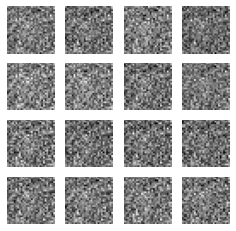

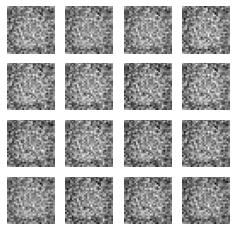

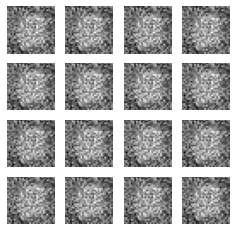

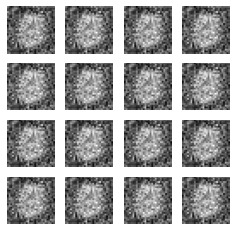

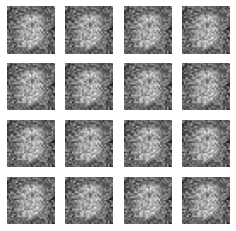

...

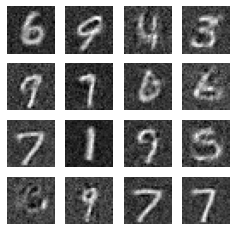

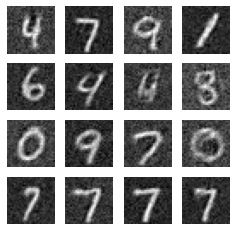

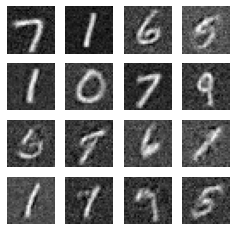

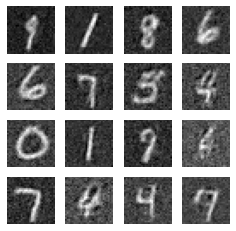

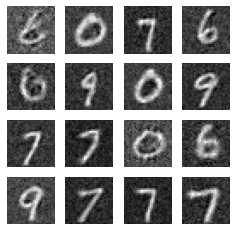

In [331]:
training_callback = Training_Callback(10, saving_rate)
gan.fit(
    train_dataset, 
    epochs=epochs,
    callbacks=[training_callback]
)

## Save Best Gen & Disc

In [332]:
training_callback.model.generator

In [333]:
disc.save_weights('./models/discriminator')
gen.save_weights('./models/generator')

## Load Weight

In [ ]:
from tensorflow.keras.models import load_model
disc1 = Discriminator()
gen1 = Generator()
disc1.load_weights('./models/discriminator')
gen1.load_weights('./models/generator')